# Project of Financial Market Analytics
The project consists of the creation of a portfolio on the time series of the past five years of given index, following the principles of the Capital Asset Pricing Model.The goal of the project is to understand the factors underlying the performance of a specific portfolio.
To understand this empirically, we need to construct real portfolios that are concentrated/inclined with respect to a specific level and type of risk, in practice it will be necessary to determine the 'amount of total risk that we take in investing in a specific portfolio, divided then into specific risk and systematic risk.
The index chosen was the Nasdaq100:is a basket of the 100 largest, most actively traded U.S companies listed on the Nasdaq stock exchange. The index includes companies from various industries except for the financial industry, like commercial and investment banks. These non-financial sectors include retail, biotechnology, industrial, technology, health care, and others.

# Packages & Imports

In [1]:
import pandas as pd
from openpyxl import Workbook
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.regression.rolling import RollingOLS
import seaborn as sns
import warnings
import plotly.express as px
import matplotlib as mpl
mpl.rcParams.update(mpl.rcParamsDefault)
import copy
from datetime import datetime
from datetime import timedelta

In [2]:
%matplotlib inline
pd.plotting.register_matplotlib_converters()
sns.set_style("darkgrid")

# Import data
Data were acquired from FactSet Research Systems Inc., trading as FactSet, is an American financial data and software company headquartered in Norwalk, Connecticut, United States. The company provides integrated data and software.

We took daily price data from 2017-07-07 to 2022-07-08 and  were checked and edited following the rules of the following paper:https://indexes.nasdaq.com/docs/Methodology_NDX.pdf

Additional information was taken from: https://www.nasdaq.com/

Null values were processed manually on excel.

In [3]:
#Is the same df, but different repository.
path = 'C:/Users/marco/OneDrive/UNIMIB_DataScience/99-PROJECTS/FinancialMarketAnalytics2022/Financial_Market_Analytics/Dataset/NASDAQ100.xlsx'
path1 =r'C:\Users\Simone\Documents\Desktop\Financial\Financial_Market_Analytics\Dataset\NASDAQ100.xlsx'

In [4]:
#Import dataset
df = pd.read_excel(path1)
df

,Date,NASDAQ_Index,"Airbnb, Inc. Class A (ABNB-US)","Lucid Group, Inc. (LCID-US)",Datadog Inc Class A (DDOG-US),"CrowdStrike Holdings, Inc. Class A (CRWD-USA)","Zscaler, Inc. (ZS-US)",Constellation Energy Corporation (CEG-US),"Fortinet, Inc. (FTNT-US)","Palo Alto Networks, Inc. (PANW-US)",...,NortonLifeLock Inc. (NLOK-US),"Henry Schein, Inc. (HSIC-US)","Illumina, Inc. (ILMN-US)","Analog Devices, Inc. (ADI-US)","Autodesk, Inc. (ADSK-US)","Mattel, Inc. (MAT-US)",Walgreens Boots Alliance Inc (WBA-US),Vodafone Group Plc Sponsored ADR (VOD-US),Fastenal Company (FAST-US),Cintas Corporation (CTAS-US)
0,2017-07-07,5656.47,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000
1,2017-07-10,5694.15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,102.076734,98.785828,98.193016,100.331337,100.406504,100.528592,99.599845,100.139470,99.681021,100.325061
2,2017-07-11,5709.80,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,102.111932,98.818640,100.604265,101.771378,100.948509,100.336377,99.767652,98.919107,99.316473,99.762150
3,2017-07-12,5778.95,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,105.315030,100.180492,100.650747,102.421308,103.252033,100.336377,100.064541,100.767085,97.334245,100.816618
4,2017-07-13,5793.36,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,106.863780,99.775763,100.517111,102.293870,103.629501,99.615569,100.697044,101.324965,98.359535,100.269563
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1255,2022-07-01,11585.68,63.167715,171.890799,269.107856,309.051724,470.818182,137.142857,745.258470,373.301506,...,NaN,NaN,110.998780,182.120556,168.273326,NaN,49.774106,NaN,226.657553,298.668041
1256,2022-07-05,11779.90,66.298113,174.216380,288.628495,322.448276,503.969697,130.809524,766.432800,382.769005,...,NaN,NaN,112.149207,182.324455,171.215641,NaN,49.709565,NaN,226.338574,297.597717
1257,2022-07-06,11852.59,64.183539,184.226491,287.696405,320.551724,496.212121,135.142857,777.734436,378.229893,...,NaN,NaN,113.526233,184.401682,171.051103,NaN,48.767265,NaN,229.756209,301.371601
1258,2022-07-07,12109.05,67.376132,200.303337,286.817577,327.931034,507.363636,140.738095,800.467612,379.911862,...,NaN,NaN,117.483005,189.333503,176.393728,NaN,49.322318,NaN,231.442242,301.982082


# Pre-Processing and Exploration
In this part, columns that did not have sufficent observations were removed and calculate log daily return and  log weekly return.

In [5]:
#Summary of NASDAQ index.
print('NASDAQ_Index')
print(df['NASDAQ_Index'].mean())
print(df['NASDAQ_Index'].median())
print(df['NASDAQ_Index'].std())

NASDAQ_Index
9865.574206349214
8358.515
3278.3909605356353


In [6]:
#Check stocks.
def interactive_plot(df_stocks, title):
  fig = px.line(title = title)
  for i in df_stocks.columns[2:]: #drop column of  nasdaq index.
    fig.add_scatter(x = df_stocks['Date'], y = df_stocks[i], name = i)
  fig.show()

interactive_plot(df, 'Prices')

In [7]:
#Daily log return.
df_daily=df.copy()
for column in df.columns[1:]:
   df_daily[column]= df_daily[column].pct_change().apply(lambda x: np.log(1+x))
display(df_daily)

,Date,NASDAQ_Index,"Airbnb, Inc. Class A (ABNB-US)","Lucid Group, Inc. (LCID-US)",Datadog Inc Class A (DDOG-US),"CrowdStrike Holdings, Inc. Class A (CRWD-USA)","Zscaler, Inc. (ZS-US)",Constellation Energy Corporation (CEG-US),"Fortinet, Inc. (FTNT-US)","Palo Alto Networks, Inc. (PANW-US)",...,NortonLifeLock Inc. (NLOK-US),"Henry Schein, Inc. (HSIC-US)","Illumina, Inc. (ILMN-US)","Analog Devices, Inc. (ADI-US)","Autodesk, Inc. (ADSK-US)","Mattel, Inc. (MAT-US)",Walgreens Boots Alliance Inc (WBA-US),Vodafone Group Plc Sponsored ADR (VOD-US),Fastenal Company (FAST-US),Cintas Corporation (CTAS-US)
0,2017-07-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2017-07-10,0.006639,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.020555,-0.012216,-0.018235,0.003308,0.004057,0.005272,-0.004010,0.001394,-0.003195,0.003245
2,2017-07-11,0.002745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.000345,0.000332,0.024260,0.014251,0.005384,-0.001914,0.001683,-0.012261,-0.003664,-0.005627
3,2017-07-12,0.012038,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.030887,0.013687,0.000462,0.006366,0.022562,0.000000,0.002971,0.018509,-0.020161,0.010514
4,2017-07-13,0.002490,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.014599,-0.004048,-0.001329,-0.001245,0.003649,-0.007210,0.006301,0.005521,0.010479,-0.005441
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1255,2022-07-01,0.007099,0.025820,-0.009368,0.059215,0.061490,0.038446,0.005920,0.013866,0.028559,...,0.000000,0.000000,0.035592,-0.022008,0.010988,0.000000,0.017264,0.000000,-0.003612,0.008477
1256,2022-07-05,0.016625,0.048368,0.013439,0.070028,0.042434,0.068044,-0.047281,0.028016,0.025045,...,0.000000,0.000000,0.010311,0.001119,0.017334,0.000000,-0.001298,0.000000,-0.001408,-0.003590
1257,2022-07-06,0.006152,-0.032415,0.055868,-0.003235,-0.005899,-0.015513,0.032590,0.014638,-0.011929,...,0.000000,0.000000,0.012204,0.011329,-0.000961,0.000000,-0.019138,0.000000,0.014987,0.012601
1258,2022-07-07,0.021407,0.048544,0.083667,-0.003059,0.022760,0.022224,0.040568,0.028811,0.004437,...,0.000000,0.000000,0.034260,0.026394,0.030756,0.000000,0.011317,0.000000,0.007312,0.002024


In [8]:
# Drop the first row (equal to zero for all stocks).
df_daily = df_daily.iloc[1:, :]
df_daily.reset_index(drop=True, inplace=True)
# Reverse data for rolling OLS.
df_daily=df_daily.reindex(index=df_daily.index[::-1])
df_daily.reset_index(drop=True, inplace=True)
display(df_daily.head())

,Date,NASDAQ_Index,"Airbnb, Inc. Class A (ABNB-US)","Lucid Group, Inc. (LCID-US)",Datadog Inc Class A (DDOG-US),"CrowdStrike Holdings, Inc. Class A (CRWD-USA)","Zscaler, Inc. (ZS-US)",Constellation Energy Corporation (CEG-US),"Fortinet, Inc. (FTNT-US)","Palo Alto Networks, Inc. (PANW-US)",...,NortonLifeLock Inc. (NLOK-US),"Henry Schein, Inc. (HSIC-US)","Illumina, Inc. (ILMN-US)","Analog Devices, Inc. (ADI-US)","Autodesk, Inc. (ADSK-US)","Mattel, Inc. (MAT-US)",Walgreens Boots Alliance Inc (WBA-US),Vodafone Group Plc Sponsored ADR (VOD-US),Fastenal Company (FAST-US),Cintas Corporation (CTAS-US)
0,2022-07-08,0.001373,-0.001540,0.009045,0.005463,0.000946,-0.003230,0.009094,0.017375,0.013385,...,0.0,0.0,-0.025851,0.009179,-0.013367,0.0,-0.017424,0.0,-0.002958,0.000472
1,2022-07-07,0.021407,0.048544,0.083667,-0.003059,0.022760,0.022224,0.040568,0.028811,0.004437,...,0.0,0.0,0.034260,0.026394,0.030756,0.0,0.011317,0.0,0.007312,0.002024
2,2022-07-06,0.006152,-0.032415,0.055868,-0.003235,-0.005899,-0.015513,0.032590,0.014638,-0.011929,...,0.0,0.0,0.012204,0.011329,-0.000961,0.0,-0.019138,0.0,0.014987,0.012601
3,2022-07-05,0.016625,0.048368,0.013439,0.070028,0.042434,0.068044,-0.047281,0.028016,0.025045,...,0.0,0.0,0.010311,0.001119,0.017334,0.0,-0.001298,0.0,-0.001408,-0.003590
4,2022-07-01,0.007099,0.025820,-0.009368,0.059215,0.061490,0.038446,0.005920,0.013866,0.028559,...,0.0,0.0,0.035592,-0.022008,0.010988,0.0,0.017264,0.0,-0.003612,0.008477


In [9]:
#Reverse start dataset to have a comparison and for next cells.
df = df.reindex(index=df_daily.index[::-1])
df.reset_index(drop=True, inplace=True)
display(df.head())

,Date,NASDAQ_Index,"Airbnb, Inc. Class A (ABNB-US)","Lucid Group, Inc. (LCID-US)",Datadog Inc Class A (DDOG-US),"CrowdStrike Holdings, Inc. Class A (CRWD-USA)","Zscaler, Inc. (ZS-US)",Constellation Energy Corporation (CEG-US),"Fortinet, Inc. (FTNT-US)","Palo Alto Networks, Inc. (PANW-US)",...,NortonLifeLock Inc. (NLOK-US),"Henry Schein, Inc. (HSIC-US)","Illumina, Inc. (ILMN-US)","Analog Devices, Inc. (ADI-US)","Autodesk, Inc. (ADSK-US)","Mattel, Inc. (MAT-US)",Walgreens Boots Alliance Inc (WBA-US),Vodafone Group Plc Sponsored ADR (VOD-US),Fastenal Company (FAST-US),Cintas Corporation (CTAS-US)
0,2022-07-07,12109.05,67.376132,200.303337,286.817577,327.931034,507.363636,140.738095,800.467612,379.911862,...,NaN,NaN,117.483005,189.333503,176.393728,NaN,49.322318,NaN,231.442242,301.982082
1,2022-07-06,11852.59,64.183539,184.226491,287.696405,320.551724,496.212121,135.142857,777.734436,378.229893,...,NaN,NaN,113.526233,184.401682,171.051103,NaN,48.767265,NaN,229.756209,301.371601
2,2022-07-05,11779.90,66.298113,174.216380,288.628495,322.448276,503.969697,130.809524,766.432800,382.769005,...,NaN,NaN,112.149207,182.324455,171.215641,NaN,49.709565,NaN,226.338574,297.597717
3,2022-07-01,11585.68,63.167715,171.890799,269.107856,309.051724,470.818182,137.142857,745.258470,373.301506,...,NaN,NaN,110.998780,182.120556,168.273326,NaN,49.774106,NaN,226.657553,298.668041
4,2022-06-30,11503.72,61.557598,173.508595,253.635153,290.620690,453.060606,136.333333,734.996065,362.791039,...,NaN,NaN,107.117541,186.173060,166.434379,NaN,48.922163,NaN,227.477785,296.146833


In [10]:
#Weekly log Returns.
df_weekly = pd.DataFrame()
j = 0
for col in df.columns[1:139]:
  Col = []
  date = []
  for i in range(3, len(df) - 7, 7):
    date.append(df['Date'][i])
    Col.append(np.log(df[col][i]) - np.log(df[col][i+7]))

  df_weekly[col] = Col   
df_weekly['Date'] = date
display(df_weekly.head())

,NASDAQ_Index,"Airbnb, Inc. Class A (ABNB-US)","Lucid Group, Inc. (LCID-US)",Datadog Inc Class A (DDOG-US),"CrowdStrike Holdings, Inc. Class A (CRWD-USA)","Zscaler, Inc. (ZS-US)",Constellation Energy Corporation (CEG-US),"Fortinet, Inc. (FTNT-US)","Palo Alto Networks, Inc. (PANW-US)","Old Dominion Freight Line, Inc. (ODFL-US)",...,"Henry Schein, Inc. (HSIC-US)","Illumina, Inc. (ILMN-US)","Analog Devices, Inc. (ADI-US)","Autodesk, Inc. (ADSK-US)","Mattel, Inc. (MAT-US)",Walgreens Boots Alliance Inc (WBA-US),Vodafone Group Plc Sponsored ADR (VOD-US),Fastenal Company (FAST-US),Cintas Corporation (CTAS-US),Date
0,0.005016,-0.085104,-0.058824,0.103767,0.078542,0.041125,-0.027568,0.029757,0.027790,0.101999,...,NaN,0.050787,-0.032630,0.027464,NaN,-0.047851,NaN,-0.002008,0.047541,2022-07-01
1,-0.026123,-0.090063,0.000555,-0.054581,-0.021551,-0.029733,-0.009748,-0.034834,-0.001819,-0.047557,...,NaN,-0.117355,-0.060892,-0.100750,NaN,-0.026590,NaN,-0.042041,-0.042351,2022-06-22
2,-0.058713,-0.069256,-0.078932,-0.013423,0.047595,0.030873,-0.062561,-0.002598,-0.013060,-0.040592,...,NaN,-0.141385,-0.048814,-0.103017,NaN,-0.040572,NaN,-0.036457,-0.041910,2022-06-10
3,0.058476,0.036380,0.058607,0.028188,0.081996,0.084366,0.116507,0.013163,0.047030,0.056907,...,NaN,-0.034640,0.014242,0.080135,NaN,0.054632,NaN,0.046706,0.072087,2022-06-01
4,-0.011086,-0.031485,0.282800,-0.031976,0.079303,0.002340,-0.012630,0.089104,0.025410,-0.107689,...,NaN,0.133549,0.066494,0.057690,NaN,-0.056711,NaN,0.017054,-0.019931,2022-05-20


In [11]:
# Check columns that do not have sufficent observations.
col_to_drop = []

for col in df.columns[1:]:
  notNan = len(df)-df[col].isna().sum()
  if notNan <= 187:
    col_to_drop.append(col)
print(col_to_drop)

['Airbnb, Inc. Class A (ABNB-US)', 'Lucid Group, Inc. (LCID-US)', 'Datadog Inc Class A (DDOG-US)', 'CrowdStrike Holdings, Inc. Class A (CRWD-USA)', 'Zscaler, Inc. (ZS-US)', 'Constellation Energy Corporation (CEG-US)', 'Fortinet, Inc. (FTNT-US)', 'Palo Alto Networks, Inc. (PANW-US)', 'Old Dominion Freight Line, Inc. (ODFL-US)', 'Astrazeneca PLC Sponsored ADR (AZN-US)', 'Honeywell International Inc. (HON-US)', 'Match Group, Inc. (MTCH-US)', 'Warner Bros. Discovery, Inc. Series A (WBD-US)', 'Norwegian Cruise Line Holdings Ltd. (NCLH-US)', 'Akamai Technologies, Inc. (AKAM-US)', 'Tractor Supply Company (TSCO-US)', 'Mattel, Inc. (MAT-US)']


In [12]:
#Drop columns.
df_final_log_ret =df_daily.copy()
df_final_log_ret.drop(col_to_drop, axis = 1, inplace = True)
len(df_final_log_ret.columns)
#columns has been removed.

122

In [13]:
#Drop date for regression.
df_reg=df_final_log_ret.iloc[:,1:] # Drop date
display(df_reg.head(5))

,NASDAQ_Index,"Peloton Interactive, Inc. Class A (PTON-US)","Moderna, Inc. (MRNA-US)","Okta, Inc. Class A (OKTA-US)","Pinduoduo, Inc. Sponsored ADR Class A (PDD-US)",Atlassian Corp. Plc Class A (TEAM-US),Keurig Dr Pepper Inc. (KDP-US),"Marvell Technology, Inc. (MRVL-US)","American Electric Power Company, Inc. (AEP-US)","Zoom Video Communications, Inc. Class A (ZM-US)",...,Microsoft Corporation (MSFT-US),NortonLifeLock Inc. (NLOK-US),"Henry Schein, Inc. (HSIC-US)","Illumina, Inc. (ILMN-US)","Analog Devices, Inc. (ADI-US)","Autodesk, Inc. (ADSK-US)",Walgreens Boots Alliance Inc (WBA-US),Vodafone Group Plc Sponsored ADR (VOD-US),Fastenal Company (FAST-US),Cintas Corporation (CTAS-US)
0,0.001373,0.0,0.021973,0.002313,-0.023247,0.001449,0.001382,0.008334,-0.001906,-0.007816,...,-0.002761,0.0,0.0,-0.025851,0.009179,-0.013367,-0.017424,0.0,-0.002958,0.000472
1,0.021407,0.0,0.077397,0.022734,0.008715,0.028084,0.005548,0.061510,-0.002958,0.030953,...,0.008193,0.0,0.0,0.034260,0.026394,0.030756,0.011317,0.0,0.007312,0.002024
2,0.006152,0.0,0.025517,-0.012065,-0.076883,-0.002595,-0.008586,0.019355,0.012953,-0.028299,...,0.012702,0.0,0.0,0.012204,0.011329,-0.000961,-0.019138,0.0,0.014987,0.012601
3,0.016625,0.0,0.036601,0.066308,0.027391,0.053622,0.005254,0.010055,-0.045640,0.081726,...,0.012519,0.0,0.0,0.010311,0.001119,0.017334,-0.001298,0.0,-0.001408,-0.003590
4,0.007099,0.0,0.048507,0.059896,0.047711,0.052544,0.019032,-0.022771,0.020734,0.027406,...,0.010651,0.0,0.0,0.035592,-0.022008,0.010988,0.017264,0.0,-0.003612,0.008477


In [14]:
# Replace zero to NaN.
for col in df_reg.columns:
    df_reg[col]=df_reg[col].replace({0:np.nan})

In [15]:
#Drop columns and reverse initial dataset.
df_final = df.drop(col_to_drop, axis = 1)
display(df_final.head())

,Date,NASDAQ_Index,"Peloton Interactive, Inc. Class A (PTON-US)","Moderna, Inc. (MRNA-US)","Okta, Inc. Class A (OKTA-US)","Pinduoduo, Inc. Sponsored ADR Class A (PDD-US)",Atlassian Corp. Plc Class A (TEAM-US),Keurig Dr Pepper Inc. (KDP-US),"Marvell Technology, Inc. (MRVL-US)","American Electric Power Company, Inc. (AEP-US)",...,Microsoft Corporation (MSFT-US),NortonLifeLock Inc. (NLOK-US),"Henry Schein, Inc. (HSIC-US)","Illumina, Inc. (ILMN-US)","Analog Devices, Inc. (ADI-US)","Autodesk, Inc. (ADSK-US)",Walgreens Boots Alliance Inc (WBA-US),Vodafone Group Plc Sponsored ADR (VOD-US),Fastenal Company (FAST-US),Cintas Corporation (CTAS-US)
0,2022-07-07,12109.05,NaN,926.881720,442.991453,233.071161,605.409233,251.541273,288.902666,136.688359,...,386.409444,NaN,NaN,117.483005,189.333503,176.393728,49.322318,NaN,231.442242,301.982082
1,2022-07-06,11852.59,NaN,857.849462,433.034188,231.048689,588.643444,250.149620,271.667700,137.093275,...,383.256551,NaN,NaN,113.526233,184.401682,171.051103,48.767265,NaN,229.756209,301.371601
2,2022-07-05,11779.90,NaN,836.236559,438.290598,249.513109,590.172756,252.306682,266.460012,135.328995,...,378.419234,NaN,NaN,112.149207,182.324455,171.215641,49.709565,NaN,226.338574,297.597717
3,2022-07-01,11585.68,NaN,806.182796,410.170940,242.771536,559.359955,250.984612,263.794172,141.648590,...,373.711489,NaN,NaN,110.998780,182.120556,168.273326,49.774106,NaN,226.657553,298.668041
4,2022-06-30,11503.72,NaN,768.010753,386.324786,231.460674,530.727839,246.252992,269.869808,138.741866,...,369.752375,NaN,NaN,107.117541,186.173060,166.434379,48.922163,NaN,227.477785,296.146833


# Rolling regression
We implement a rolling regression for each stock of the dataset and we used a 180-day window. 

The function used was taken from: https://www.statsmodels.org/dev/generated/statsmodels.regression.rolling.RollingOLS.html

In [16]:
def OLS_reg(x,y):
    X=sm.add_constant(x)
    mod=sm.OLS(y,X,missing='drop')
    res=mod.fit()
    return res

In [17]:
# Rolling OLS function 
def Rolling_OLS(x, y, window, step_length, date=[], reverse=True):

    if reverse:
        x = x[len(x)::-1].reset_index(drop = True)
        y = y[len(y)::-1].reset_index(drop = True)
        date = date[len(date)::-1].reset_index(drop = True)

    # Max number of iterations 
    max_iteration = int((len(x) - window)/(step_length)) + 1

    # Results for each regressione
    if list(date) == []:
        rolling_res=list()
    else:
        rolling_res=dict()
    # Regression
    for i in range(max_iteration):
        start=i*step_length
        end=i*step_length + window

        if y[start:end+step_length+1].isna().sum() > 0:
            continue;

        res=OLS_reg(x[start:end], y[start:end])

        if list(date) == []:
            rolling_res.append(res)
        else:
            key=str(date[end])
            rolling_res[key] = res

    return rolling_res

In [18]:
#Regressor X.
x = df_reg.iloc[:,0]

#Rolling OLS results.
results = {}
for i in range(1, len(df_reg.columns)):
    col = df_reg.columns[i]
    y=df_reg.iloc[:,i]
    results[col] = Rolling_OLS(x, y, 180, 7, df_final_log_ret['Date'], reverse=True) 

In [19]:
results

{'Peloton Interactive, Inc. Class A (PTON-US)': {'2021-09-16 00:00:00': <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x1fd6a9baf10>,
  '2021-09-27 00:00:00': <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x1fd6a9a7f10>,
  '2021-10-06 00:00:00': <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x1fd69f47b20>,
  '2021-10-15 00:00:00': <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x1fd6a9aad00>,
  '2021-10-26 00:00:00': <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x1fd6a9aa040>,
  '2021-11-04 00:00:00': <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x1fd6a9aef40>,
  '2021-11-15 00:00:00': <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x1fd6a9af880>,
  '2021-11-24 00:00:00': <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x1fd6a9af100>,
  '2021-12-06 00:00:00': <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x1fd6a9b1ac0>}

In [20]:
results['Peloton Interactive, Inc. Class A (PTON-US)']['2021-09-27 00:00:00'].summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                         OLS Regression Results                                        
=======================================================================================================
Dep. Variable:     Peloton Interactive, Inc. Class A (PTON-US)   R-squared:                       0.140
Model:                                                     OLS   Adj. R-squared:                  0.135
Method:                                          Least Squares   F-statistic:                     29.00
Date:                                         Wed, 21 Sep 2022   Prob (F-statistic):           2.27e-07
Time:                                                 17:44:41   Log-Likelihood:                 338.28
No. Observations:                                          180   AIC:                            -672.6
Df Residuals:                                              178   BIC:                            -666.2
Df Model:                                                    1                                         
Covariance Type:                                     nonrobust                                         
================================================================================
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const           -0.0041      0.003     -1.459      0.146      -0.010       0.001
NASDAQ_Index     1.3073      0.243      5.385      0.000       0.828       1.786
==============================================================================
Omnibus:                        7.833   Durbin-Watson:                   2.077
Prob(Omnibus):                  0.020   Jarque-Bera (JB):               14.054
Skew:                          -0.090   Prob(JB):                     0.000888
Kurtosis:                       4.357   Cond. No.                         87.7
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [21]:
#Check date of results.
print(len(results['Expedia Group, Inc. (EXPE-US)'].keys())) #numbers models.
print(results['Expedia Group, Inc. (EXPE-US)'].keys())

71
dict_keys(['2018-03-27 00:00:00', '2019-01-07 00:00:00', '2019-01-16 00:00:00', '2019-01-28 00:00:00', '2019-02-06 00:00:00', '2019-02-15 00:00:00', '2019-02-27 00:00:00', '2019-03-08 00:00:00', '2019-03-19 00:00:00', '2019-03-28 00:00:00', '2019-04-08 00:00:00', '2019-04-17 00:00:00', '2019-04-29 00:00:00', '2019-05-08 00:00:00', '2019-05-17 00:00:00', '2019-05-29 00:00:00', '2019-06-07 00:00:00', '2019-06-18 00:00:00', '2019-06-27 00:00:00', '2019-07-09 00:00:00', '2019-07-18 00:00:00', '2019-07-29 00:00:00', '2019-08-07 00:00:00', '2019-08-16 00:00:00', '2019-08-27 00:00:00', '2019-09-06 00:00:00', '2019-09-17 00:00:00', '2019-09-26 00:00:00', '2019-10-07 00:00:00', '2019-10-16 00:00:00', '2019-10-25 00:00:00', '2019-11-05 00:00:00', '2019-11-14 00:00:00', '2019-11-25 00:00:00', '2019-12-05 00:00:00', '2019-12-16 00:00:00', '2019-12-26 00:00:00', '2020-01-07 00:00:00', '2020-01-16 00:00:00', '2020-01-28 00:00:00', '2020-02-06 00:00:00', '2020-02-18 00:00:00', '2020-02-27 00:00:00

# Building portfolios
At this stage, portfolios were constructed on the different parameters, following CAPM rules.

The Capital Asset Pricing Model (CAPM) describes the relationship between systematic risk, or the general perils of investing, and expected return for assets, particularly stocks.

CAPM evolved as a way to measure this systematic risk. It is widely used throughout finance for pricing risky securities and generating expected returns for assets, given the risk of those assets and cost of capital.

In [22]:
#Portfolio costruction
def build_portfolio(dict_param, alpha = True):  
  date_list = list(results['Adobe Incorporated (ADBE-US)'].keys()) # Dict in order to store the RR results for build the Portfolios

  portfolio = {}
  for i in date_list:
    ordered_list = (sorted(dict_param[i].items(), key = lambda x: x[1], reverse = True))
    values = []
    for j in range(len(ordered_list)):
      values.append(ordered_list[j][1])
    values.sort(reverse = True)
    perc_80 = np.percentile(values, 80)
    perc_list = []
    for j in range(len(ordered_list)):
      if(ordered_list[j][1] >= perc_80):
        perc_list.append(ordered_list[j])
    
    
    if(alpha == False):
      to_pop = []
      for t in perc_list:
        if float(results[t[0]][i].t_test('const=0').summary_frame()['P>|t|']) > 0.05:
          to_pop.append(t)
      for el in to_pop:
        perc_list.remove(el)
        
    portfolio[i] = perc_list
  return portfolio
#Store results in a dict, where key is a name of parameter

In [23]:
#set up the portfolio where we store the results.
portfolios = dict()

###  Portfolios based on R2, Alpha & Beta
R_squared: computed the ratio between systematic and specific risk.

Alpha: the excess return, obtained from intercept of model.

Beta: the sensitive to movement in the overall market.

These results were obtained direclty from the model.

In [24]:
date_list = list(results['Adobe Incorporated (ADBE-US)'].keys()) # Dict in order to store the RR results for build the Portfolios
r2 = {}
alpha = {}
beta = {}
for i in date_list:
  r2[i] = {}
  alpha[i] = {}
  beta[i] = {}
  for el in results:
    if(i in results[el]):
      r2[i][el] = results[el][i].rsquared
      alpha[i][el] = results[el][i].params[0]
      beta[i][el] = results[el][i].params[1] 
portfolios['r_squared'] = build_portfolio(r2)
portfolios['alpha'] = build_portfolio(alpha, alpha = True)
portfolios['beta'] = build_portfolio(beta)

In [25]:
#Example how to store results.
portfolios['r_squared']

{'2018-03-27 00:00:00': [('Alphabet Inc. Class C (GOOG-US)',
   0.7677111544728049),
  ('Cisco Systems, Inc. (CSCO-US)', 0.5573550108457264),
  ('Lam Research Corporation (LRCX-US)', 0.5374644236958559),
  ('Amazon.com, Inc. (AMZN-US)', 0.5058964850129062),
  ('NVIDIA Corporation (NVDA-US)', 0.48845880312320944),
  ('Intuit Inc. (INTU-US)', 0.4802983869830132),
  ('Microchip Technology Incorporated (MCHP-US)', 0.42283430077312034),
  ('Adobe Incorporated (ADBE-US)', 0.403268465684536),
  ('Amgen Inc. (AMGN-US)', 0.40197046366428413)],
 '2018-04-06 00:00:00': [('Alphabet Inc. Class C (GOOG-US)',
   0.7780413479333385),
  ('Cisco Systems, Inc. (CSCO-US)', 0.5946664542736116),
  ('Lam Research Corporation (LRCX-US)', 0.5619539772235254),
  ('Amazon.com, Inc. (AMZN-US)', 0.5406571606806814),
  ('NVIDIA Corporation (NVDA-US)', 0.5248658212517436),
  ('Intuit Inc. (INTU-US)', 0.48597922796761694),
  ('Netflix, Inc. (NFLX-US)', 0.4737882436509928),
  ('Microchip Technology Incorporated (MCHP-

### Portfolios based on risk
Systematic risk: computed as beta squared time of the market.

Specific risk: computed as variance for each stock.

Total risk: computed as sum of specific and systematic risk.

In [26]:
date_list = list(results['Adobe Incorporated (ADBE-US)'].keys())
#Create new dataset for compute parameters.
date_list_2 = df_final.reindex(index = df_final.index[::-1]) 
date_list_2.reset_index(inplace = True, drop = True)
#df for compute specific risk.
df_regression_2 = df_reg.reindex(index = df_reg.index[::-1]) 
df_regression_2.reset_index(inplace = True, drop = True)
#Index for systematic risk.
market_index = df_regression_2['NASDAQ_Index']
df_regression_2.drop('NASDAQ_Index', axis = 1, inplace = True)
index_list = []
for i in date_list:
  for j in range(len(date_list_2)):
    if(str(date_list_2['Date'][j]) == i):
      index_list.append(j)
systematic_risk = {}
specific_risk = {}
total_risk = {}
momentum = {}
for i in date_list:
  systematic_risk[i] = {}
  specific_risk[i] = {}
  total_risk[i] = {}
  for j in index_list:
    if(str(date_list_2['Date'][j]) == i):
      row = j
  for el in results:
    if(i in results[el]):
      col =  el 
      specific_risk[i][el] = df_regression_2[col][row-180:row].var()
      systematic_risk[i][el] = (market_index[row-180:row].var())*(results[el][i].params[1]**2)
      total_risk[i][el] = specific_risk[i][el] + systematic_risk[i][el]
portfolios['systematic_risk'] = build_portfolio(systematic_risk)
portfolios['specific_risk'] = build_portfolio(specific_risk)
portfolios['total_risk'] = build_portfolio(total_risk)

### Portfolio based on momentum strategy
Momentum strategy measures the velocity of price changes as opposed to the actual price levels themselves. 

Momentum is measured by continually taking price differences for a fixed time period. 

In [27]:
#Create new dataset for momentum
df_final_3 = df_final.reindex(index = df_final.index[::-1]) 
df_final_3.reset_index(inplace = True, drop = True)

In [28]:
#List of index.
index_list = []
for i in date_list:
  for j in range(len(date_list_2)):
    if(str(date_list_2['Date'][j]) == i):
      index_list.append(j)

In [29]:
date_list = list(results['Adobe Incorporated (ADBE-US)'].keys())
momentum = {}
for i in date_list:
  momentum[i] = {}
  for j in index_list:
    if(str(date_list_2['Date'][j]) == i):
      row = j
  for x in results:
    if(i in results[x]):
      col =  el 
      momentum[i][x] = np.log(df_final_3[x][row]) - np.log(df_final_3[x][row-180]) 
portfolios['momentum'] = build_portfolio(momentum)

### Portofolio based on Alpha_Return & R2_Beta
Alpha_Return: the ratio between excess returns and total returns.

R2_Beta: the product between R squared and Beta.

In [30]:
date_list = list(results['Adobe Incorporated (ADBE-US)'].keys())
alpha_return = {}
for i in date_list:
  alpha_return[i] = {key: alpha[i][key]/momentum[i].get(key, 0) for key in alpha[i]}
portfolios['alpha_return'] = build_portfolio(alpha_return)

<ipython-input-30-2343fd5d20e8>:4: RuntimeWarning:

divide by zero encountered in double_scalars



In [31]:
date_list = list(results['Adobe Incorporated (ADBE-US)'].keys())
r2_beta = {}
beta_2 = copy.deepcopy(beta)
for i in date_list:
  for j in beta_2[i]:
    if beta_2[i][j] < 1:
      beta_2[i][j] = beta_2[i][j]*-1
for i in date_list:
  r2_beta[i] = {key: r2[i][key]*beta_2[i].get(key, 0) for key in r2[i]}
portfolios['r2_beta'] = build_portfolio(r2_beta)

### Index Nasdaq_100
Take value of index nasdaq for comparision

In [32]:
index_Nasdaq = dict()

for key in portfolios['momentum'].keys():
  index_Nasdaq[key] = [('NASDAQ_Index', 0)]

portfolios['NASDAQ_Index'] = index_Nasdaq

### Final portfolio
In this dictionary we have archived all the portfolios to analyze them

In [33]:
#10 portfolios constructed.
portfolios.keys()

dict_keys(['r_squared', 'alpha', 'beta', 'systematic_risk', 'specific_risk', 'total_risk', 'momentum', 'alpha_return', 'r2_beta', 'NASDAQ_Index'])

In [34]:
#Results of constructed portfolios.
portfolios

{'r_squared': {'2018-03-27 00:00:00': [('Alphabet Inc. Class C (GOOG-US)',
    0.7677111544728049),
   ('Cisco Systems, Inc. (CSCO-US)', 0.5573550108457264),
   ('Lam Research Corporation (LRCX-US)', 0.5374644236958559),
   ('Amazon.com, Inc. (AMZN-US)', 0.5058964850129062),
   ('NVIDIA Corporation (NVDA-US)', 0.48845880312320944),
   ('Intuit Inc. (INTU-US)', 0.4802983869830132),
   ('Microchip Technology Incorporated (MCHP-US)', 0.42283430077312034),
   ('Adobe Incorporated (ADBE-US)', 0.403268465684536),
   ('Amgen Inc. (AMGN-US)', 0.40197046366428413)],
  '2018-04-06 00:00:00': [('Alphabet Inc. Class C (GOOG-US)',
    0.7780413479333385),
   ('Cisco Systems, Inc. (CSCO-US)', 0.5946664542736116),
   ('Lam Research Corporation (LRCX-US)', 0.5619539772235254),
   ('Amazon.com, Inc. (AMZN-US)', 0.5406571606806814),
   ('NVIDIA Corporation (NVDA-US)', 0.5248658212517436),
   ('Intuit Inc. (INTU-US)', 0.48597922796761694),
   ('Netflix, Inc. (NFLX-US)', 0.4737882436509928),
   ('Microchi

# Portfolios assessment

## Portfolios returns

In [35]:
#Function for return values.
def portfolio_value(portfolios_return, capital):
  portfolio_values = dict()
  current_value = capital
  portfolio_values[list(portfolios_return.keys())[0] - timedelta(1)] = current_value

  for key in portfolios_return.keys():
    current_value = current_value*np.exp(portfolios_return[key])
    portfolio_values[key] = current_value

  return portfolio_values

In [36]:
#Set initial capital.
capital = 100

### Daily return
Take values of log-returns between the initial date and the final date for compute weekly and annual return

In [37]:
#Function for compute window.
def window_daily_log_returns(assets, initial_date_index, end_date_index):
  log_returns = dict()

  for asset in assets:
    log_ret = df_daily[asset][len(df_daily[asset])::-1].reset_index(drop = True)
    log_returns[asset] = log_ret[initial_date_index:end_date_index].reset_index(drop = True)
  return log_returns

In [38]:
#Function for daily return.
def portfolio_daily_return(portfolios, date, window_size, step_length, reverse = True):
  daily_portfolio_return = dict()

  if reverse:
    date = date[len(date)::-1].reset_index(drop = True)

  for i in range(len(portfolios.keys())):
    initial_date_index = window_size+step_length*i
    end_date_index = window_size+step_length*i+step_length
    

    initial_date = date[initial_date_index]

    portfolio = portfolios[str(initial_date)]
    
    portfolio_assets = list(map(lambda x: x[0], portfolio))

    # Compute the weight of each asset
    for asset in portfolio_assets:
      log_ret = df_daily[asset][len(df_daily[asset])::-1].reset_index(drop = True)
      log_ret_2 = log_ret[initial_date_index:end_date_index].reset_index(drop = True)
      if(log_ret_2.isnull().sum() != 0):
        portfolio_assets.remove(asset)
    num_assets = len(portfolio_assets)
    
    if num_assets != 0:
      weight = 1/num_assets

      # Retrieve log returns of each asset.
      assets_log_return = window_daily_log_returns(portfolio_assets, initial_date_index, end_date_index)

      # The last portfolio have only three value for each assets, so we exit the loop before to go out of index
      for j in range(step_length):
        if initial_date_index+j+1 >= len(date):
          break

      # We compute the log return of the ith portfolio
        portfolio_return = 0
        for asset in assets_log_return.keys():
          portfolio_return = portfolio_return + weight*np.exp(assets_log_return[asset][j])

        daily_portfolio_return[date[initial_date_index+j+1]] = np.log(portfolio_return)

    else:
      for j in range(step_length):
        if initial_date_index+j+1 >= len(date):
          break

        daily_portfolio_return[date[initial_date_index+j+1]] = 0

  return daily_portfolio_return

In [39]:
#Results of daily return.
portfolios_daily = dict()
for key in portfolios.keys():
  portfolios_daily[key] = portfolio_daily_return(portfolios[key], df_final_log_ret['Date'], 180, 7)
portfolios_daily

{'r_squared': {Timestamp('2018-03-28 00:00:00'): -0.04346405426721054,
  Timestamp('2018-03-29 00:00:00'): -0.01975378649314942,
  Timestamp('2018-04-02 00:00:00'): 0.02008150068084834,
  Timestamp('2018-04-03 00:00:00'): -0.03575260453795115,
  Timestamp('2018-04-04 00:00:00'): 0.013338578450581711,
  Timestamp('2018-04-05 00:00:00'): 0.015978540701154446,
  Timestamp('2018-04-06 00:00:00'): -0.004045782381491767,
  Timestamp('2018-04-09 00:00:00'): -0.026336445780336747,
  Timestamp('2018-04-10 00:00:00'): 0.005961754130892204,
  Timestamp('2018-04-11 00:00:00'): 0.028228746457627067,
  Timestamp('2018-04-12 00:00:00'): -0.0010714298641425317,
  Timestamp('2018-04-13 00:00:00'): 0.01793775081798509,
  Timestamp('2018-04-16 00:00:00'): -0.009083073241471342,
  Timestamp('2018-04-17 00:00:00'): 0.00301317797867754,
  Timestamp('2018-04-18 00:00:00'): 0.03768738422333509,
  Timestamp('2018-04-19 00:00:00'): -0.0031406123959827467,
  Timestamp('2018-04-20 00:00:00'): -0.01490510985517718

### Weekly returns


In [40]:
#Function for compute weekly return.
def portfolio_weekly_return(daily_portfolio_return):
  weekly_portfolio_return = dict()

  for i in range(len(daily_portfolio_return.keys())):
    ret = 0
    if i%7 == 0:

      for j in range(7):
        if i+j >= len(daily_portfolio_return):
          break

        key = list(daily_portfolio_return.keys())[i+j]
        ret = ret + daily_portfolio_return[key]

        end_date = list(daily_portfolio_return.keys())[i+j]
      
      weekly_portfolio_return[end_date] = ret

  return weekly_portfolio_return

In [41]:
#Results of daily return.
portfolios_weekly= dict()
for key in portfolios_daily.keys():
  portfolios_weekly[key] = portfolio_weekly_return(portfolios_daily[key])
portfolios_weekly

{'r_squared': {Timestamp('2018-04-06 00:00:00'): -0.05361760784721838,
  Timestamp('2018-04-17 00:00:00'): 0.018650480499231285,
  Timestamp('2018-04-26 00:00:00'): -0.018832887643323686,
  Timestamp('2018-05-07 00:00:00'): 0.05891250573131568,
  Timestamp('2018-05-16 00:00:00'): 0.022056314276410485,
  Timestamp('2018-05-25 00:00:00'): 0.015640227643347805,
  Timestamp('2018-06-06 00:00:00'): 0.04092327049320293,
  Timestamp('2018-06-15 00:00:00'): -0.004476326024429248,
  Timestamp('2018-06-26 00:00:00'): -0.05760128096450239,
  Timestamp('2018-07-06 00:00:00'): 0.00873383420572417,
  Timestamp('2018-07-17 00:00:00'): 0.02825148844682462,
  Timestamp('2018-07-26 00:00:00'): 0.021877128382268185,
  Timestamp('2018-08-06 00:00:00'): 0.003708702227832246,
  Timestamp('2018-08-15 00:00:00'): -0.0036347740902113257,
  Timestamp('2018-08-24 00:00:00'): -0.0015678376737643124,
  Timestamp('2018-09-05 00:00:00'): 0.02748400091215549,
  Timestamp('2018-09-14 00:00:00'): -0.0319945743868808,
 

In [42]:
#Results of weekly return.
portfolios_weekly_values = dict()
for key in portfolios.keys():
  portfolios_weekly_values[key] = portfolio_value(portfolios_weekly[key], capital)

In [43]:
#Build dataset of weekly return.
df_portfolios_weekly_values = pd.DataFrame(index = list(portfolios_weekly_values['NASDAQ_Index'].keys()), columns=list(portfolios_weekly_values.keys()))

for key in portfolios_weekly_values.keys():
  df_portfolios_weekly_values[key] = list(portfolios_weekly_values[key].values())
df_portfolios_weekly_values

,r_squared,alpha,beta,systematic_risk,specific_risk,total_risk,momentum,alpha_return,r2_beta,NASDAQ_Index
2018-04-05,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000
2018-04-06,94.779447,97.377126,94.067634,94.067634,97.195295,95.370606,96.637070,99.848261,94.070252,97.645928
2018-04-17,96.563716,98.381555,95.329639,95.329639,100.036081,96.952663,98.820241,99.056993,95.711648,98.835476
2018-04-26,94.762160,96.830119,92.130273,92.130273,98.270804,93.789578,96.771379,98.336381,93.461579,96.448089
2018-05-07,100.512558,101.107835,97.887683,97.887683,102.165926,99.219309,101.046500,99.803703,98.848275,100.226390
...,...,...,...,...,...,...,...,...,...,...
2022-05-26,184.997132,146.141540,186.023577,186.023577,105.418950,119.713977,198.932842,169.113446,161.102786,176.846767
2022-06-07,198.678510,155.528568,201.262329,201.262329,116.491885,132.288425,204.179171,171.565244,174.880558,186.555332
2022-06-16,181.038630,142.844602,178.723559,178.723559,105.934805,120.840446,189.199252,157.532759,157.011604,171.662153
2022-06-28,184.601415,146.157837,188.205420,188.205420,112.652816,128.887535,196.030806,165.784552,163.389933,177.798967


In [44]:
fig = px.line(title = 'Weekly Portfolios Returns')
for i in df_portfolios_weekly_values[1:3]:
    fig.add_scatter(x = df_portfolios_weekly_values.index, y = df_portfolios_weekly_values[i], name = i)

fig.show()

### Annual returns

In [45]:
#Portfolio for 
def portfolio_total_average_annual_log_returns(average_weekly_returns):
  return np.mean(list(average_weekly_returns.values()))*52

In [46]:
portfolios_total_average_annual_log_return = dict()
for key in portfolios_weekly.keys():
  portfolios_total_average_annual_log_return[key] = portfolio_total_average_annual_log_returns(portfolios_weekly[key])
portfolios_total_average_annual_log_return

{'r_squared': 0.20353663212824463,
 'alpha': 0.13256992634428405,
 'beta': 0.21333510728139926,
 'systematic_risk': 0.21333510728139926,
 'specific_risk': 0.04893113784402825,
 'total_risk': 0.09512787029755959,
 'momentum': 0.2335137280743479,
 'alpha_return': 0.1723147313267143,
 'r2_beta': 0.16515816947575332,
 'NASDAQ_Index': 0.1971419122625241}

In [47]:
#Set color
color = ['#167192','#03ED3A','orangered', "yellow", 'purple', "#b30000", "#8be04e", "blue", 'gold','red']
col_dict = dict()
for i in range(len(df_portfolios_weekly_values.columns)):
  col_dict[list(df_portfolios_weekly_values.columns)[i]] = color[i]

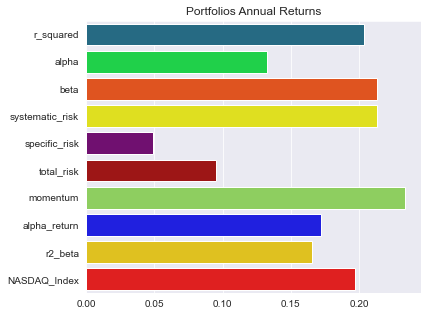

In [48]:
annual_return = plt.figure(figsize=(6,5))
sns.barplot(x=list(portfolios_total_average_annual_log_return.values()), y=list(portfolios_total_average_annual_log_return.keys()), orient='h', 
            palette = col_dict)
plt.title('Portfolios Annual Returns')
plt.show()

In [49]:
#annual_return.savefig('annual_return',dpi = 300, facecolor = 'w', bbox_inches = 'tight', pad_inches = 0.2)

## Volatility
Compute weekly and annual volatility for each portfolio with correlation matrix and standard deviation of each assets.

### Weekly volatility

In [50]:
def weekly_volatility(assets_data_weekly):
  risk = 0

  corr_matrix = dict()
  for key1 in assets_data_weekly.keys():
    for key2 in assets_data_weekly.keys():
      i = min(len(assets_data_weekly[key1]),len(assets_data_weekly[key2]))
      corr_matrix[(key1,key2)] = np.corrcoef(assets_data_weekly[key1][:i], assets_data_weekly[key2][:i])[0,1]
 
  
  volatility = dict()
  for key in assets_data_weekly.keys():
    volatility[key] = np.std(assets_data_weekly[key])

  if len(assets_data_weekly.keys()) != 0:
    weight = 1/len(assets_data_weekly.keys())

    for key in corr_matrix.keys():
      if key[0] == key[1]:
        risk = risk + volatility[key[0]]*volatility[key[1]]*corr_matrix[key] 
      else:
        risk = risk + 2*volatility[key[0]]*volatility[key[1]]*corr_matrix[key] 

    return weight*np.sqrt(risk)

  else:
    return 0    

In [51]:
def portfolio_weekly_volatility(portfolio, window_size):
  portfolios_compositions_weekly_volatility = dict()

  for dt in portfolio.keys():
    # index of the final date
    final_index_date = df_daily.index[df_daily['Date'] == dt].tolist()[0]

    #index initial date 
    initial_index_date = df_daily.index[df_daily['Date'] == dt].tolist()[0] + int(window_size/7) 

    assets_volatility = dict()
    for asset in portfolio[dt]:
      assets_volatility[asset[0]] = df_daily[asset[0]].iloc[final_index_date:initial_index_date]

    portfolios_compositions_weekly_volatility[dt] = weekly_volatility(assets_volatility)

  return portfolios_compositions_weekly_volatility

In [52]:
portfolios_weekly_volatility = dict()
for key in portfolios.keys():
  portfolios_weekly_volatility[key] = portfolio_weekly_volatility(portfolios[key],180)
portfolios_weekly_volatility

{'r_squared': {'2018-03-27 00:00:00': 0.025558830226919425,
  '2018-04-06 00:00:00': 0.03048604220095819,
  '2018-04-17 00:00:00': 0.03099771809283245,
  '2018-04-26 00:00:00': 0.031151305597719614,
  '2018-05-07 00:00:00': 0.021172145353206603,
  '2018-05-16 00:00:00': 0.018939181502084984,
  '2018-05-25 00:00:00': 0.014982465711205163,
  '2018-06-06 00:00:00': 0.012733910338055628,
  '2018-06-15 00:00:00': 0.011941250184888546,
  '2018-06-26 00:00:00': 0.014342851455745032,
  '2018-07-06 00:00:00': 0.017243404918357397,
  '2018-07-17 00:00:00': 0.016039929120553985,
  '2018-07-26 00:00:00': 0.01587759354275748,
  '2018-08-06 00:00:00': 0.014354778072345897,
  '2018-08-15 00:00:00': 0.014106080050346899,
  '2018-08-24 00:00:00': 0.012684322589284577,
  '2018-09-05 00:00:00': 0.011430863250816735,
  '2018-09-14 00:00:00': 0.012132437147691634,
  '2018-09-25 00:00:00': 0.013343956954915553,
  '2018-10-04 00:00:00': 0.014142704310944504,
  '2018-10-15 00:00:00': 0.026325568739915706,
  '

In [53]:
df_portfolios_weekly_volatility = pd.DataFrame(index = list(portfolios_weekly_volatility['NASDAQ_Index'].keys()), columns = list(portfolios_weekly_volatility.keys()))

for key in df_portfolios_weekly_volatility.keys():
  df_portfolios_weekly_volatility[key] = list(portfolios_weekly_volatility[key].values())
df_portfolios_weekly_volatility

,r_squared,alpha,beta,systematic_risk,specific_risk,total_risk,momentum,alpha_return,r2_beta,NASDAQ_Index
2018-03-27 00:00:00,0.025559,0.021985,0.026829,0.026829,0.022263,0.026062,0.022739,0.015228,0.027606,0.015637
2018-04-06 00:00:00,0.030486,0.022417,0.031230,0.031230,0.026228,0.028358,0.022629,0.020516,0.030967,0.017171
2018-04-17 00:00:00,0.030998,0.023327,0.032553,0.032553,0.026786,0.028772,0.026486,0.017597,0.032175,0.017805
2018-04-26 00:00:00,0.031151,0.026404,0.034420,0.034420,0.027821,0.031901,0.026404,0.018846,0.033496,0.018451
2018-05-07 00:00:00,0.021172,0.015941,0.022858,0.022858,0.018967,0.021683,0.018416,0.017308,0.021918,0.012408
...,...,...,...,...,...,...,...,...,...,...
2022-05-26 00:00:00,0.042491,0.038887,0.060212,0.060212,0.060208,0.060208,0.024699,0.023654,0.055249,0.027469
2022-06-07 00:00:00,0.038588,0.036631,0.058181,0.058181,0.061007,0.062225,0.022419,0.034383,0.053342,0.025303
2022-06-16 00:00:00,0.041163,0.038024,0.060271,0.060271,0.060395,0.061308,0.024490,0.030377,0.052572,0.025079
2022-06-28 00:00:00,0.038911,0.030088,0.055919,0.055919,0.055781,0.056379,0.020715,0.024614,0.049200,0.023891


### Annual volatility

In [54]:
def portfolio_annual_volatility(portfolios_compositions_weekly_volatility):
  portfolios_compositions_annual_volatility = dict()

  for date in portfolios_compositions_weekly_volatility.keys():
    portfolios_compositions_annual_volatility[date] = portfolios_compositions_weekly_volatility[date]*np.sqrt(52)

  return portfolios_compositions_annual_volatility

In [55]:
portfolios_annual_volatility = dict()
for key in portfolios.keys():
  portfolios_annual_volatility[key] = portfolio_annual_volatility(portfolios_weekly_volatility[key])

In [56]:
df_portfolios_annual_volatility = pd.DataFrame(index = list(portfolios_annual_volatility['NASDAQ_Index'].keys()), columns = list(portfolios_annual_volatility.keys()))

for key in portfolios_annual_volatility.keys():
  df_portfolios_annual_volatility[key] = list(portfolios_annual_volatility[key].values())
df_portfolios_annual_volatility

,r_squared,alpha,beta,systematic_risk,specific_risk,total_risk,momentum,alpha_return,r2_beta,NASDAQ_Index
2018-03-27 00:00:00,0.184307,0.158538,0.193463,0.193463,0.160541,0.187932,0.163972,0.109814,0.199070,0.112757
2018-04-06 00:00:00,0.219838,0.161651,0.225204,0.225204,0.189131,0.204491,0.163181,0.147941,0.223308,0.123819
2018-04-17 00:00:00,0.223528,0.168214,0.234746,0.234746,0.193155,0.207481,0.190990,0.126892,0.232014,0.128395
2018-04-26 00:00:00,0.224635,0.190399,0.248204,0.248204,0.200617,0.230039,0.190399,0.135900,0.241542,0.133053
2018-05-07 00:00:00,0.152675,0.114954,0.164831,0.164831,0.136774,0.156355,0.132799,0.124809,0.158052,0.089476
...,...,...,...,...,...,...,...,...,...,...
2022-05-26 00:00:00,0.306407,0.280419,0.434194,0.434194,0.434168,0.434168,0.178109,0.170568,0.398408,0.198084
2022-06-07 00:00:00,0.278261,0.264148,0.419548,0.419548,0.439927,0.448709,0.161667,0.247936,0.384658,0.182460
2022-06-16 00:00:00,0.296828,0.274191,0.434618,0.434618,0.435516,0.442101,0.176597,0.219054,0.379100,0.180845
2022-06-28 00:00:00,0.280590,0.216965,0.403237,0.403237,0.402239,0.406551,0.149375,0.177496,0.354787,0.172277


In [57]:
fig = px.line(title = 'Portfolios Volatility')
for i in df_portfolios_weekly_values.columns:
    fig.add_scatter(x = df_portfolios_annual_volatility.index, y = df_portfolios_annual_volatility[i], name = i)

fig.show()

In [58]:
def portfolio_annual_average_volatility(portfolios_compositions_weekly_volatility):
  return np.mean(list(portfolios_compositions_weekly_volatility.values()))*np.sqrt(52)

In [59]:
portfolios_annual_average_volatility = dict()
for key in portfolios.keys():
  portfolios_annual_average_volatility[key] = portfolio_annual_average_volatility(portfolios_weekly_volatility[key])
portfolios_annual_average_volatility

{'r_squared': 0.16771148984082215,
 'alpha': 0.15356844299041045,
 'beta': 0.21056789401377982,
 'systematic_risk': 0.21056789401377982,
 'specific_risk': 0.20413634470218084,
 'total_risk': 0.21030667185748506,
 'momentum': 0.1590718666948433,
 'alpha_return': 0.1409718369987472,
 'r2_beta': 0.1902111302351259,
 'NASDAQ_Index': 0.10212060477867878}

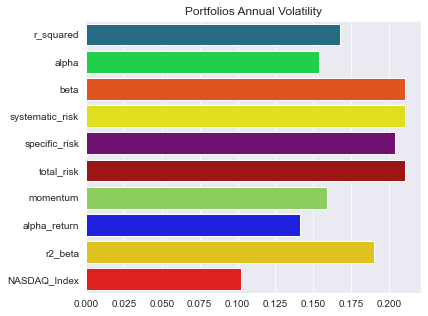

In [60]:
annual_volatility = plt.figure(figsize=(6,5))
sns.barplot(x=list(portfolios_annual_average_volatility.values()), y=list(portfolios_annual_average_volatility.keys()), orient='h', 
            palette = col_dict)
plt.title('Portfolios Annual Volatility')
plt.show()

In [61]:
#annual_volatility.savefig('annual_volatility',dpi = 300, facecolor = 'w', bbox_inches = 'tight', pad_inches = 0.2)

## Efficiency
Compute efficency with annual average log return and annual average volatility return

In [62]:
portfolio_efficiency = dict()
for key in portfolios_total_average_annual_log_return:
  portfolio_efficiency[key] = (portfolios_total_average_annual_log_return[key]/portfolios_annual_average_volatility[key])
portfolio_efficiency

{'r_squared': 1.2136117347799171,
 'alpha': 0.8632628146953496,
 'beta': 1.0131416675869795,
 'systematic_risk': 1.0131416675869795,
 'specific_risk': 0.2396983149444309,
 'total_risk': 0.45232930300006496,
 'momentum': 1.4679762859784042,
 'alpha_return': 1.2223344392415458,
 'r2_beta': 0.8682886709710214,
 'NASDAQ_Index': 1.9304812450903572}

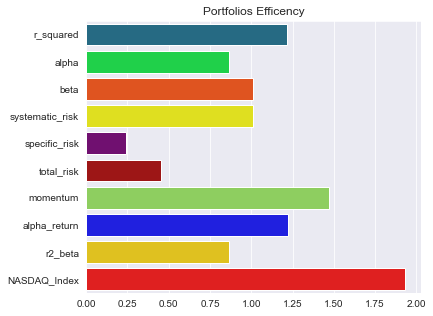

In [63]:
efficiency = plt.figure(figsize=(6,5))
sns.barplot(x=list(portfolio_efficiency.values()), y=list(portfolio_efficiency.keys()), orient='h', 
            palette = col_dict)
plt.title('Portfolios Efficency')
plt.show()

In [64]:
#efficiency.savefig('efficiency',dpi = 300, facecolor = 'w', bbox_inches = 'tight', pad_inches = 0.2)



Remo Marconzini 883256

Simone Farallo 889719